# PERSONAL BANK LOAN ANALYSIS

In [34]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold, cross_val_score
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report, RocCurveDisplay, ConfusionMatrixDisplay
from scipy import stats
from sklearn.base import clone 
from imblearn.over_sampling import RandomOverSampler
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import confusion_matrix
import shap
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import precision_recall_curve
from scipy.stats import pointbiserialr, spearmanr
from sklearn.preprocessing import StandardScaler
import warnings
from sklearn.exceptions import ConvergenceWarning
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.utils import shuffle



## Dataset overview

In [35]:
df = pd.read_csv("data/train_data.csv")
df.head(10)

,ID,Age,Experience,Income,ZIP Code,Family,CCAvg,Education,Mortgage,Personal Loan,Securities Account,CD Account,Online,CreditCard,Date
0,409,60,36,89,91745,2,2/80,1.0,0,0,0,0,1,0,2023-05-11
1,3738,44,19,30,91423,1,0/50,3.0,0,0,0,0,1,0,2023-05-31
2,3890,26,0,19,93014,1,0/10,2.0,121,0,0,0,1,0,2023-07-25
3,569,34,9,41,92101,2,0/10,1.0,161,0,0,0,1,1,2023-08-14
4,1042,56,32,51,92780,4,1/50,1.0,0,0,0,0,0,0,2023-08-13
5,1128,35,9,58,91101,1,2/50,1.0,0,0,0,0,1,1,2023-05-24
6,3077,29,-1,62,92672,2,1/75,3.0,0,0,0,0,0,1,2023-06-09
7,4617,66,41,114,92521,1,0/80,3.0,0,0,0,0,1,1,2023-06-11
8,4989,34,8,85,95134,1,2/50,1.0,136,0,0,0,0,1,2023-06-07
9,3578,39,9,32,91016,3,2/00,NaN,0,0,0,0,1,0,2023-08-26


In [36]:
df.tail(10)

,ID,Age,Experience,Income,ZIP Code,Family,CCAvg,Education,Mortgage,Personal Loan,Securities Account,CD Account,Online,CreditCard,Date
3990,1050,35,10,23,94501,4,0/20,3.0,0,0,0,0,1,0,2023-05-25
3991,1939,30,4,38,90245,1,1/90,3.0,0,0,0,0,1,0,2023-07-29
3992,1411,60,35,44,92126,4,2/10,1.0,0,0,0,0,0,0,2023-05-28
3993,1699,44,20,149,92121,1,1/70,1.0,0,0,0,0,1,0,2023-06-02
3994,3684,53,27,62,95070,3,3/00,2.0,0,0,1,0,0,0,2023-05-20
3995,4588,37,11,59,94720,4,0/20,3.0,0,0,0,0,0,0,2023-07-21
3996,2342,36,10,91,92028,1,1/50,3.0,289,0,0,0,1,0,2023-08-24
3997,1586,57,31,131,90502,2,2/70,1.0,0,0,0,0,0,0,2023-05-08
3998,3153,40,15,83,90275,1,1/00,3.0,0,0,0,0,0,0,2023-06-06
3999,4786,30,5,23,94304,2,0/90,3.0,0,0,1,0,1,0,2023-06-08


- ID: ID of the customer

- Age: Age of the customer in completed years

- Experience: Amount of work experience in years

- Income: Amount of annual income (in thousands)

- Zipcode: Postal code in which the client lives

- Family: Number of family members

- CCAvg: Average monthly spending with the credit card (in thousands)

- Education: Education level (1: bachelor's degree, 2: master's degree, 3: advanced/professional degree)

- Mortgage: Value of home mortgage, if any (in thousands)

- Securities Account: Does the customer have a securities account with the bank?

- CD Account: Does the customer have a certificate of deposit account (CD) with the bank?

- Online: Does the customer use the internet banking facilities?

- CreditCard: Does the customer use a credit card issued by the bank?

- Personal Loan: Did this customer accept the personal loan offered in the last campaign? (Target Variable)

In [37]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4000 entries, 0 to 3999
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   ID                  4000 non-null   int64  
 1   Age                 4000 non-null   int64  
 2   Experience          4000 non-null   int64  
 3   Income              4000 non-null   int64  
 4   ZIP Code            4000 non-null   int64  
 5   Family              4000 non-null   int64  
 6   CCAvg               4000 non-null   object 
 7   Education           3900 non-null   float64
 8   Mortgage            4000 non-null   int64  
 9   Personal Loan       4000 non-null   int64  
 10  Securities Account  4000 non-null   int64  
 11  CD Account          4000 non-null   int64  
 12  Online              4000 non-null   int64  
 13  CreditCard          4000 non-null   int64  
 14  Date                4000 non-null   object 
dtypes: float64(1), int64(12), object(2)
memory usage: 468.9

In [38]:
df.isnull().sum().sum()

100

In [39]:
df['Personal Loan'].value_counts()

Personal Loan
0    3616
1     384
Name: count, dtype: int64

In [40]:
pd.set_option('display.max_rows', 20)
round(df.describe().T, 2)

,count,mean,std,min,25%,50%,75%,max
ID,4000.0,2497.68,1449.72,1.0,1245.75,2492.5,3767.25,5000.0
Age,4000.0,45.43,11.49,23.0,35.00,45.0,55.00,67.0
Experience,4000.0,20.20,11.50,-3.0,10.00,20.0,30.00,43.0
Income,4000.0,73.48,46.32,8.0,38.00,63.0,98.00,224.0
ZIP Code,4000.0,93156.58,2197.76,9307.0,91941.75,93407.0,94608.00,96651.0
Family,4000.0,2.38,1.15,1.0,1.00,2.0,3.00,4.0
Education,3900.0,1.88,0.84,1.0,1.00,2.0,3.00,3.0
Mortgage,4000.0,55.97,101.05,0.0,0.00,0.0,100.00,635.0
Personal Loan,4000.0,0.10,0.29,0.0,0.00,0.0,0.00,1.0
Securities Account,4000.0,0.10,0.31,0.0,0.00,0.0,0.00,1.0


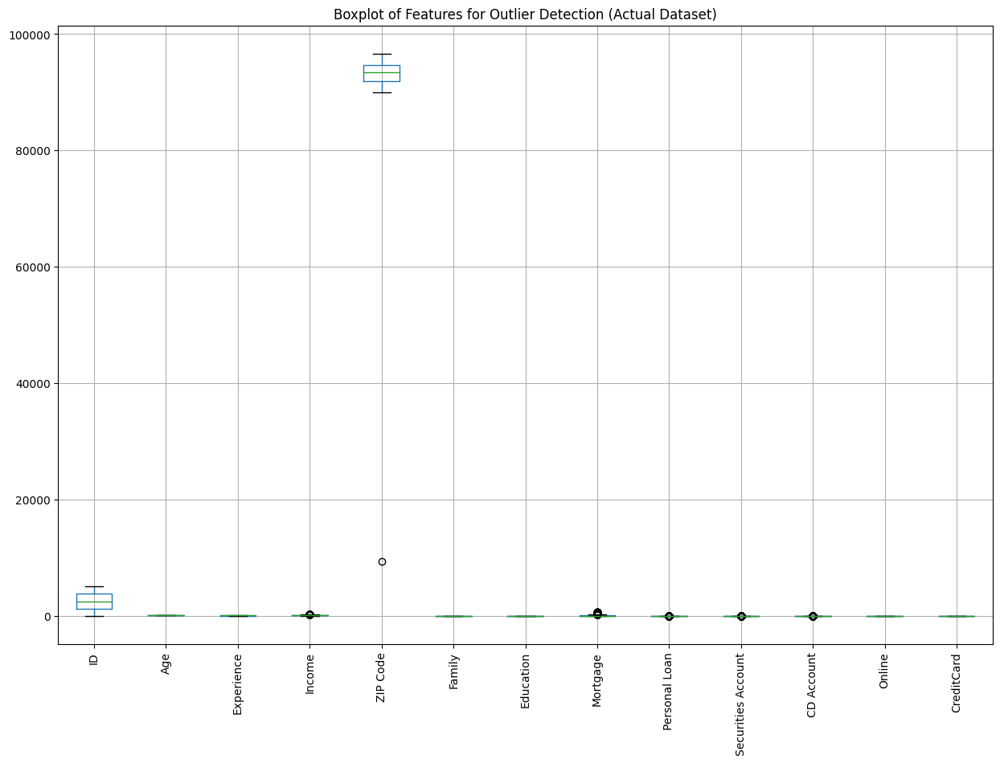

In [41]:
plt.figure(figsize=(15, 10))
df.boxplot()
plt.xticks(rotation=90)
plt.title('Boxplot of Features for Outlier Detection (Actual Dataset)')
plt.show()

In [42]:
df.duplicated().sum()

0

In [43]:
df['CCAvg'] 

0       2/80
1       0/50
2       0/10
3       0/10
4       1/50
        ... 
3995    0/20
3996    1/50
3997    2/70
3998    1/00
3999    0/90
Name: CCAvg, Length: 4000, dtype: object

In [44]:
df['CCAvg'] = df['CCAvg'].astype(str).str.replace('/', '.')
df['CCAvg'] = pd.to_numeric(df['CCAvg'])

df['CCAvg']

0       2.8
1       0.5
2       0.1
3       0.1
4       1.5
       ... 
3995    0.2
3996    1.5
3997    2.7
3998    1.0
3999    0.9
Name: CCAvg, Length: 4000, dtype: float64

## Data cleaning

1. Check negative values in Experience and remove noise

In [45]:
df[df['Experience']<0]['Experience'].count()

39

In [46]:
df[df['Experience']<0]['Experience'].value_counts()

Experience
-1    25
-2    10
-3     4
Name: count, dtype: int64

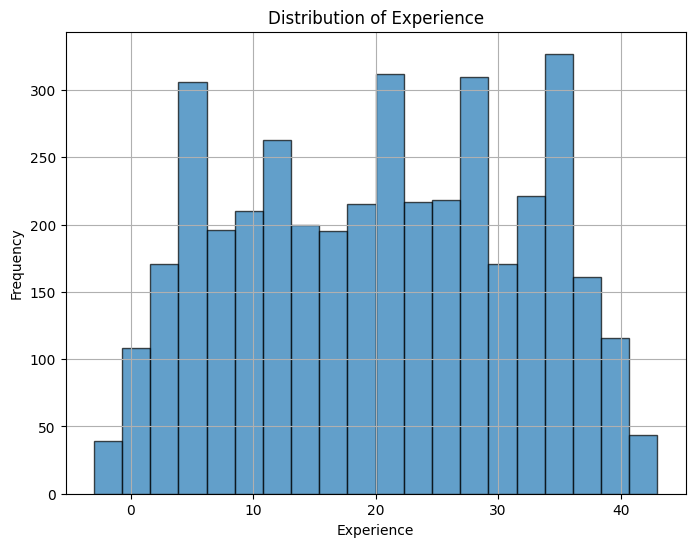

In [47]:
df['Experience'].describe()

plt.figure(figsize=(8,6))
plt.hist(df['Experience'], bins=20, edgecolor='black', alpha=0.7)
plt.title('Distribution of Experience')
plt.xlabel('Experience')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

Replace negative values with their absolute value 

In [48]:
df['Experience'] = df['Experience'].apply(abs)

2. Drop ID column

In [49]:
df.drop(['ID'], axis= 1, inplace= True)

3. remove outliers from mortgage using Z-score

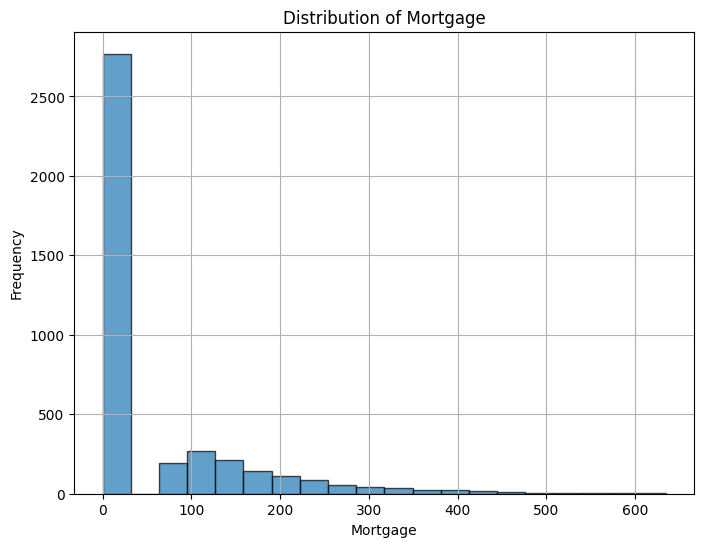

In [50]:
df['Mortgage'].describe()

plt.figure(figsize=(8,6))
plt.hist(df['Mortgage'], bins=20, edgecolor='black', alpha=0.7)
plt.title('Distribution of Mortgage')
plt.xlabel('Mortgage')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

In [51]:
z_scores = np.abs(stats.zscore(df['Mortgage']))
threshold = 3
df_no_outliers = df[(z_scores < threshold)]

4. Drop ZIP code and date columns

In [52]:
df.drop(['ZIP Code'], axis= 1, inplace= True)

In [53]:
df.drop(['Date'], axis=1, inplace= True)

5. remove missing values in education filling with the most frequent value of records having the same income

In [54]:
df['Education'] = df.groupby('Income')['Education'].transform(lambda x: x.fillna(x.mode()[0] if not x.mode().empty else x))

# Check if all missing values in 'Education' have been filled
if df['Education'].isna().sum() == 0:
    print("All missing values in the Education column have been filled.")
else:
    print("There are still some missing values in the Education column.")

df.head(10)

All missing values in the Education column have been filled.


,Age,Experience,Income,Family,CCAvg,Education,Mortgage,Personal Loan,Securities Account,CD Account,Online,CreditCard
0,60,36,89,2,2.80,1.0,0,0,0,0,1,0
1,44,19,30,1,0.50,3.0,0,0,0,0,1,0
2,26,0,19,1,0.10,2.0,121,0,0,0,1,0
3,34,9,41,2,0.10,1.0,161,0,0,0,1,1
4,56,32,51,4,1.50,1.0,0,0,0,0,0,0
5,35,9,58,1,2.50,1.0,0,0,0,0,1,1
6,29,1,62,2,1.75,3.0,0,0,0,0,0,1
7,66,41,114,1,0.80,3.0,0,0,0,0,1,1
8,34,8,85,1,2.50,1.0,136,0,0,0,0,1
9,39,9,32,3,2.00,1.0,0,0,0,0,1,0


### Distribution of key features

In [55]:
# fig, ax = plt.subplots(4, 3, figsize=(12, 20))
# for i, col in enumerate(df):
#     sns.histplot(df[col], ax= ax[i//3, i%3])
# plt.show()

### Correlation

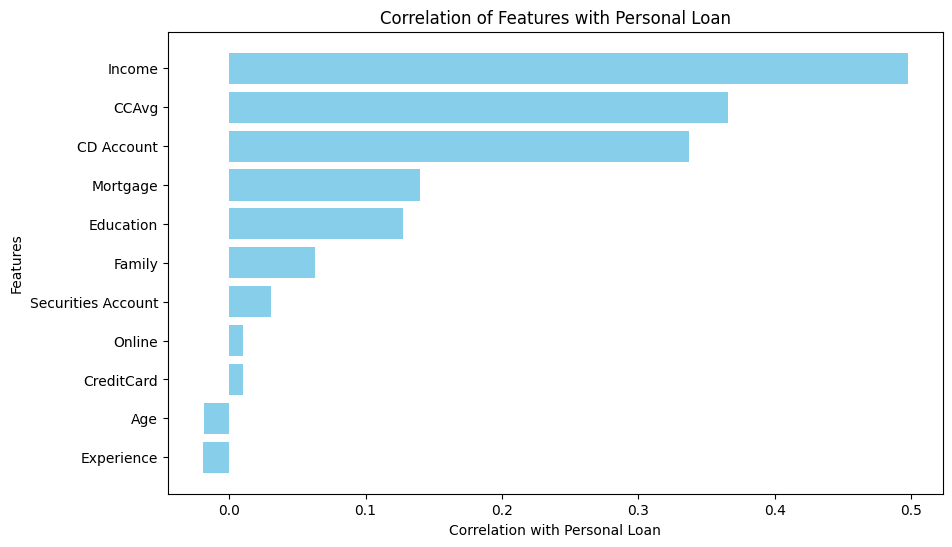

In [56]:
correlation_results = {}
for col in df.columns:
    if col != 'Personal Loan':

        if np.issubdtype(df[col].dtype, np.number):
            correlation, _ = pointbiserialr(df['Personal Loan'], df[col])
            correlation_results[col] = correlation
        else:
            correlation, _ = spearmanr(df['Personal Loan'], df[col])
            correlation_results[col] = correlation

correlation_df = pd.DataFrame(list(correlation_results.items()), columns=['Feature', 'Correlation'])
correlation_df.sort_values(by='Correlation', ascending=False, inplace=True)

plt.figure(figsize=(10, 6))
plt.barh(correlation_df['Feature'], correlation_df['Correlation'], color='skyblue')
plt.xlabel('Correlation with Personal Loan')
plt.ylabel('Features')
plt.title('Correlation of Features with Personal Loan')
plt.gca().invert_yaxis()  
plt.show()

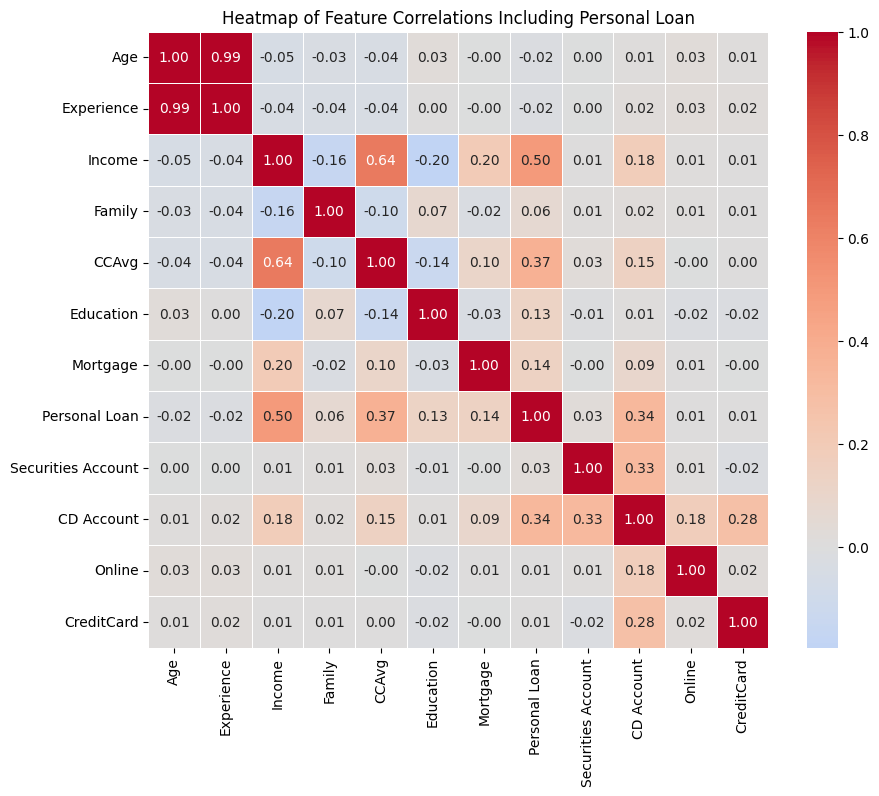

In [57]:
# inclung only 'float64', 'int64' because it excludes the dates 
df_numeric = df.select_dtypes(include=['float64', 'int64'])

# Compute the correlation matrix
corr_matrix = df_numeric.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0, linewidths=0.5, fmt='.2f')
plt.title('Heatmap of Feature Correlations Including Personal Loan')
plt.show()

## Divide in train and test

In [58]:
X = df.drop('Personal Loan', axis=1)  
y = df['Personal Loan'] 

In [59]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

### Perform oversampling on train set for unbalanced classes

In [60]:
def custom_oversample(X, y, target_ratio=1.0, random_state=None):
    """
    Custom oversampling function with adjustable ratio between minority and majority classes.

    Parameters:
    - X: Features dataframe.
    - y: Target series.
    - target_ratio: Desired ratio of minority to majority samples (default is 1.0 for 1:1 ratio).
    - random_state: Seed for reproducibility (default is None).

    Returns:
    - X_resampled: Resampled features dataframe.
    - y_resampled: Resampled target series.
    """

    if random_state is not None:
        np.random.seed(random_state)

    if not isinstance(X, pd.DataFrame):
        X = pd.DataFrame(X)

    class_counts = y.value_counts()
    majority_class = class_counts.idxmax()
    minority_class = class_counts.idxmin()

    X_majority = X[y == majority_class]
    X_minority = X[y == minority_class]

    n_samples_in_majority = len(X_majority)
    n_samples_in_minority = len(X_minority)
    n_samples_to_add = int((target_ratio * n_samples_in_majority) - n_samples_in_minority)

    if n_samples_to_add > 0:
        X_minority_oversampled = X_minority.sample(n=n_samples_to_add, replace=True)
        X_resampled = pd.concat([X_majority, X_minority, X_minority_oversampled])
        y_resampled = pd.concat([pd.Series([majority_class] * n_samples_in_majority), 
                                 pd.Series([minority_class] * (n_samples_in_minority + n_samples_to_add))])
    else:
        # If the target_ratio is lower, do not oversample, return the original data
        X_resampled = pd.concat([X_majority, X_minority])
        y_resampled = pd.concat([pd.Series([majority_class] * n_samples_in_majority),
                                 pd.Series([minority_class] * n_samples_in_minority)])

    X_resampled, y_resampled = shuffle(X_resampled, y_resampled, random_state=random_state)

    return X_resampled, y_resampled

In [61]:
X_train_resampled, y_train_resampled = custom_oversample(X_train, y_train, target_ratio= 0.7, random_state=42)

print("Original class distribution in training set:")
print(y_train.value_counts())

print("\nResampled class distribution in training set:")
print(y_train_resampled.value_counts())

Original class distribution in training set:
Personal Loan
0    2908
1     292
Name: count, dtype: int64

Resampled class distribution in training set:
0    2908
1    2035
Name: count, dtype: int64


# Models

## Logistic Regression

In [62]:
scaler = StandardScaler()

pipeline_logreg = Pipeline([
    ('scaler', scaler),
    ('logreg', LogisticRegression(random_state=42, max_iter=1000))
])

In [63]:
pipeline_logreg.fit(X_train_resampled, y_train_resampled)
y_pred_logreg = pipeline_logreg.predict(X_test)
logreg = pipeline_logreg.named_steps['logreg']

### Model evaluation

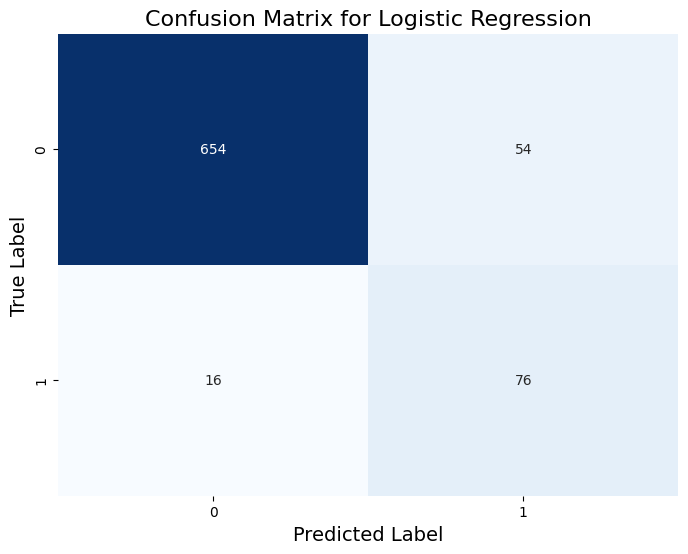

In [64]:
conf_matrix = confusion_matrix(y_test, y_pred_logreg)

plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix for Logistic Regression', fontsize=16)
plt.ylabel('True Label', fontsize=14)
plt.xlabel('Predicted Label', fontsize=14)
plt.show()

In [65]:
accuracy = accuracy_score(y_test, y_pred_logreg)
precision = precision_score(y_test, y_pred_logreg)
recall = recall_score(y_test, y_pred_logreg)
f1 = f1_score(y_test, y_pred_logreg)
roc_auc_logreg = roc_auc_score(y_test, pipeline_logreg.predict_proba(X_test)[:, 1]
)

metrics_table = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC'],
    'Score': [accuracy, precision, recall, f1, roc_auc_logreg]
})

metrics_table

,Metric,Score
0,Accuracy,0.912500
1,Precision,0.584615
2,Recall,0.826087
3,F1 Score,0.684685
4,ROC AUC,0.950949


- feature importance

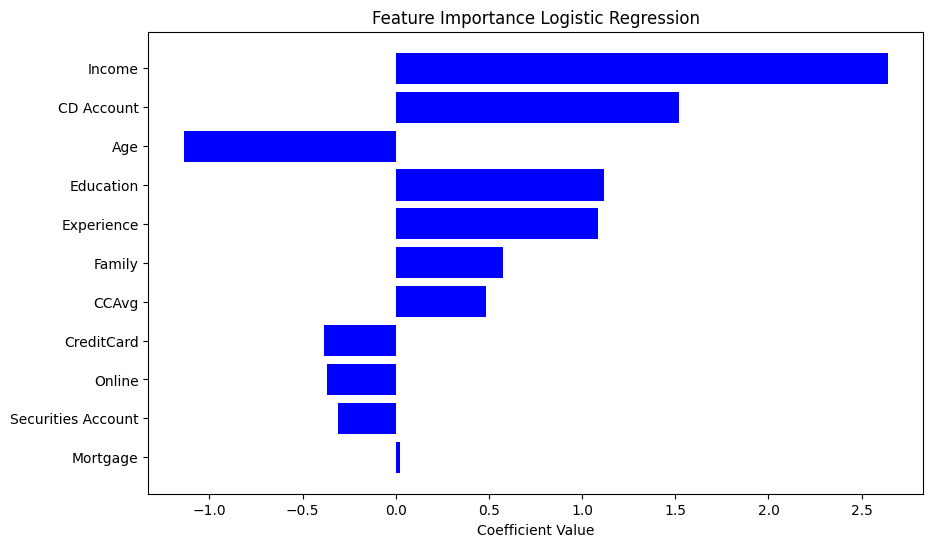

In [66]:
coefficients_lr = logreg.coef_.flatten()

features = X_train.columns  
importance_lr = pd.DataFrame({
    'Feature': features,
    'Importance': coefficients_lr
})

importance_lr['Absolute Importance'] = np.abs(importance_lr['Importance'])
importance = importance_lr.sort_values(by='Absolute Importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(importance['Feature'], importance['Importance'], color='b')
plt.xlabel('Coefficient Value')
plt.title('Feature Importance Logistic Regression')
plt.gca().invert_yaxis()  
plt.show()

### Feature selection

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=1, Cross-Validation Accuracy: 0.8434


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=2, Cross-Validation Accuracy: 0.8584


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=3, Cross-Validation Accuracy: 0.8748


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=4, Cross-Validation Accuracy: 0.8817


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=5, Cross-Validation Accuracy: 0.8843


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=6, Cross-Validation Accuracy: 0.8845


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=7, Cross-Validation Accuracy: 0.8857


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=8, Cross-Validation Accuracy: 0.8845


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=9, Cross-Validation Accuracy: 0.8887


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=10, Cross-Validation Accuracy: 0.8904


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

k=11, Cross-Validation Accuracy: 0.8879


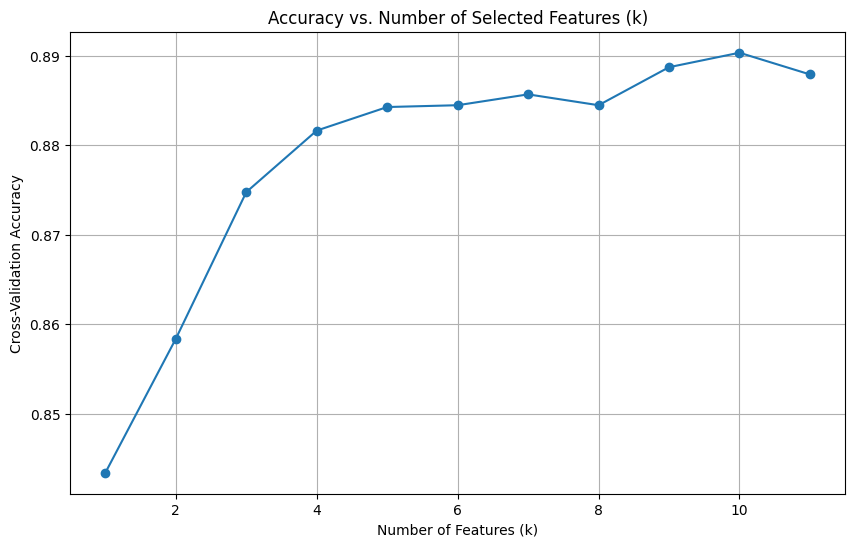

Optimal number of features: 10


In [67]:
logreg = LogisticRegression(random_state=42, max_iter=1000)

k_values = range(1, 12)
scores = []

for k in k_values:
    sfs = SFS(logreg,
              k_features=k,
              forward=True,
              floating=True, 
              scoring='accuracy',  
              cv=5)  
    
    pipeline_logreg = Pipeline([
        ('scaler', StandardScaler()),
        ('sfs', sfs),
        ('logreg', logreg)
    ])
    
    score = cross_val_score(pipeline_logreg, X_train_resampled, y_train_resampled, cv=5, scoring='accuracy').mean()
    scores.append(score)
    print(f"k={k}, Cross-Validation Accuracy: {score:.4f}")

plt.figure(figsize=(10, 6))
plt.plot(k_values, scores, marker='o')
plt.xlabel('Number of Features (k)')
plt.ylabel('Cross-Validation Accuracy')
plt.title('Accuracy vs. Number of Selected Features (k)')
plt.grid(True)
plt.show()

best_k = k_values[scores.index(max(scores))]
print(f"Optimal number of features: {best_k}")


In [68]:
sfs_optimal = SFS(logreg,
                  k_features=best_k,
                  forward=True,
                  floating=True, 
                  scoring='accuracy',  
                  cv=5)  

pipeline_logreg_optimal = Pipeline([
    ('scaler', StandardScaler()),
    ('sfs', sfs_optimal),
    ('logreg', logreg)
])

pipeline_logreg_optimal.fit(X_train_resampled, y_train_resampled)

y_pred_logreg = pipeline_logreg_optimal.predict(X_test)

selected_features_optimal = pipeline_logreg_optimal.named_steps['sfs'].k_feature_names_
print("Selected Features with Optimal k:", selected_features_optimal)


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` in

Selected Features with Optimal k: ('0', '1', '2', '3', '4', '5', '6', '7', '8', '9')


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_validation.py:73: FutureWarning: `fit_params` is deprecated and will be removed in version 1.6. Pass parameters via `params` instead.
  warnings.warn(


In [69]:
print("Selected Features:", selected_features_optimal)

Selected Features: ('0', '1', '2', '3', '4', '5', '6', '7', '8', '9')


In [70]:
selected_feature_indices = [int(i) for i in selected_features_optimal]
selected_feature_names = X_train_resampled.columns[selected_feature_indices]

X_train_selected = X_train_resampled[selected_feature_names]
X_test_selected = X_test[selected_feature_names]
selected_feature_names

Index(['Age', 'Experience', 'Income', 'Family', 'CCAvg', 'Education',
       'Mortgage', 'Securities Account', 'CD Account', 'Online'],
      dtype='object')

In [71]:
X_train_scaled = scaler.fit_transform(X_train_selected)
X_test_scaled = scaler.transform(X_test_selected)

# Fit the logistic regression model on the scaled training data
final_logreg = LogisticRegression(random_state=42, max_iter=1000)
final_logreg.fit(X_train_scaled, y_train_resampled)

# Make predictions on the scaled test data
y_pred_final = final_logreg.predict(X_test_scaled)

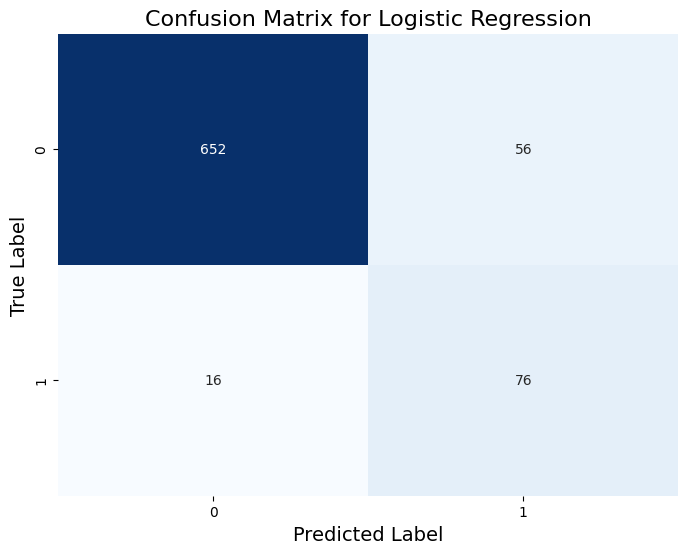

In [72]:
conf_matrix = confusion_matrix(y_test, y_pred_final)

plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix for Logistic Regression', fontsize=16)
plt.ylabel('True Label', fontsize=14)
plt.xlabel('Predicted Label', fontsize=14)
plt.show()

In [73]:
accuracy = accuracy_score(y_test, y_pred_final)
precision = precision_score(y_test, y_pred_final)
recall = recall_score(y_test, y_pred_final)
f1 = f1_score(y_test, y_pred_final)

roc_auc_logreg = roc_auc_score(y_test, final_logreg.predict_proba(X_test_scaled)[:, 1])

metrics_table2 = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC'],
    'Score': [accuracy, precision, recall, f1, roc_auc_logreg]
})

metrics_table2

,Metric,Score
0,Accuracy,0.910000
1,Precision,0.575758
2,Recall,0.826087
3,F1 Score,0.678571
4,ROC AUC,0.947525


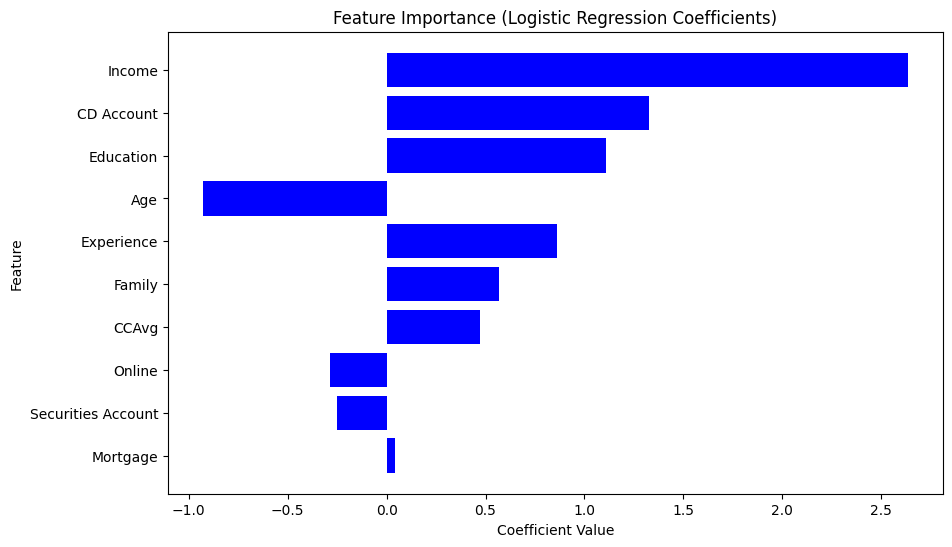

In [74]:
feature_names = X_train_selected.columns 
coefficients = final_logreg.coef_[0]  

feature_importance = pd.DataFrame({
    'Feature': feature_names,
    'Importance': coefficients
})

feature_importance['Abs_Importance'] = feature_importance['Importance'].apply(np.abs)
feature_importance = feature_importance.sort_values(by='Abs_Importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(feature_importance['Feature'], feature_importance['Importance'], color='blue')
plt.xlabel('Coefficient Value')
plt.ylabel('Feature')
plt.title('Feature Importance (Logistic Regression Coefficients)')
plt.gca().invert_yaxis()  
plt.show()


### Comparison

In [75]:
combined_metrics_table = pd.merge(
    metrics_table, 
    metrics_table2, 
    on='Metric'
)

combined_metrics_table.columns = ['Metric', 'Model without Feature Selection', 'Model with Feature Selection']

combined_metrics_table

,Metric,Model without Feature Selection,Model with Feature Selection
0,Accuracy,0.912500,0.910000
1,Precision,0.584615,0.575758
2,Recall,0.826087,0.826087
3,F1 Score,0.684685,0.678571
4,ROC AUC,0.950949,0.947525


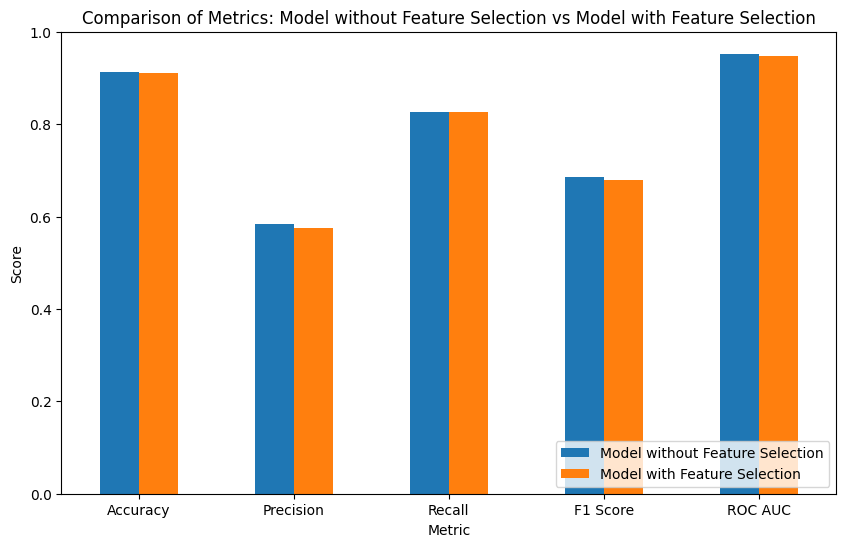

In [76]:
combined_metrics_table.plot(x='Metric', kind='bar', figsize=(10, 6), rot=0)
plt.title('Comparison of Metrics: Model without Feature Selection vs Model with Feature Selection')
plt.ylabel('Score')
plt.ylim(0, 1)  # Since metrics are typically between 0 and 1
plt.legend(loc="lower right")
plt.show()

## Random Forest

In [112]:
param_grid_rf = {
    'n_estimators': [50, 100, 150],            
    'max_depth': [3, 5, 7],                    
    'min_samples_split': [10, 15, 20],         
    'min_samples_leaf': [5, 10],               
    'bootstrap': [True]                        
}

In [ ]:
rf = RandomForestClassifier(random_state=42, class_weight='balanced')  
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=10, verbose=1)  

In [ ]:
grid_search.fit(X_train, y_train)

Fitting 10 folds for each of 54 candidates, totalling 540 fits
Unexpected exception formatting exception. Falling back to standard exception


Traceback (most recent call last):
  File "/Users/soniaborsi/Library/Python/3.12/lib/python/site-packages/IPython/core/interactiveshell.py", line 3548, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/var/folders/q8/7ss60v9d2t91mvvwbkcjcd3h0000gn/T/ipykernel_1097/20025057.py", line 1, in <module>
    grid_search.fit(X_train, y_train)
  File "/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/base.py", line 1351, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_search.py", line 970, in fit
    self._run_search(evaluate_candidates)
  File "/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/sklearn/model_selection/_search.py", line 1527, in _run_search
    evaluate_candidates(ParameterGrid(self.param_grid))
  File "/Library/Fr

In [ ]:
print("Best params:")
print(grid_search.best_params_)

Best params:
{'bootstrap': True, 'max_depth': 7, 'min_samples_leaf': 5, 'min_samples_split': 15, 'n_estimators': 50}


In [ ]:
best_rf = grid_search.best_estimator_
y_pred_rf = best_rf.predict(X_test)
# classification_report(y_test, y_pred)

### Model evaluation

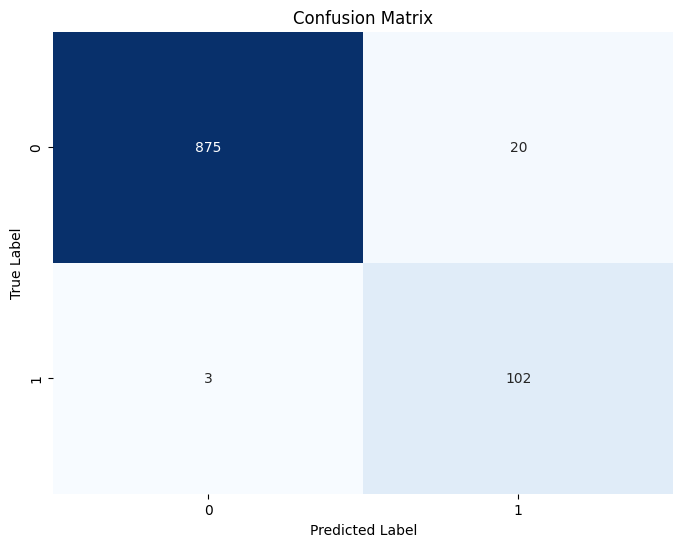

In [ ]:
conf_matrix_rf = confusion_matrix(y_test, y_pred_rf)

plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix_rf, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

In [ ]:
accuracy = accuracy_score(y_test, y_pred_rf)
precision = precision_score(y_test, y_pred_rf)
recall = recall_score(y_test, y_pred_rf)
f1 = f1_score(y_test, y_pred_rf)
roc_auc = roc_auc_score(y_test, best_rf.predict_proba(X_test)[:, 1])

metrics_table = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC'],
    'Score': [accuracy, precision, recall, f1, roc_auc]
})

metrics_table

,Metric,Score
0,Accuracy,0.977000
1,Precision,0.836066
2,Recall,0.971429
3,F1 Score,0.898678
4,ROC AUC,0.998212


- Feature importance

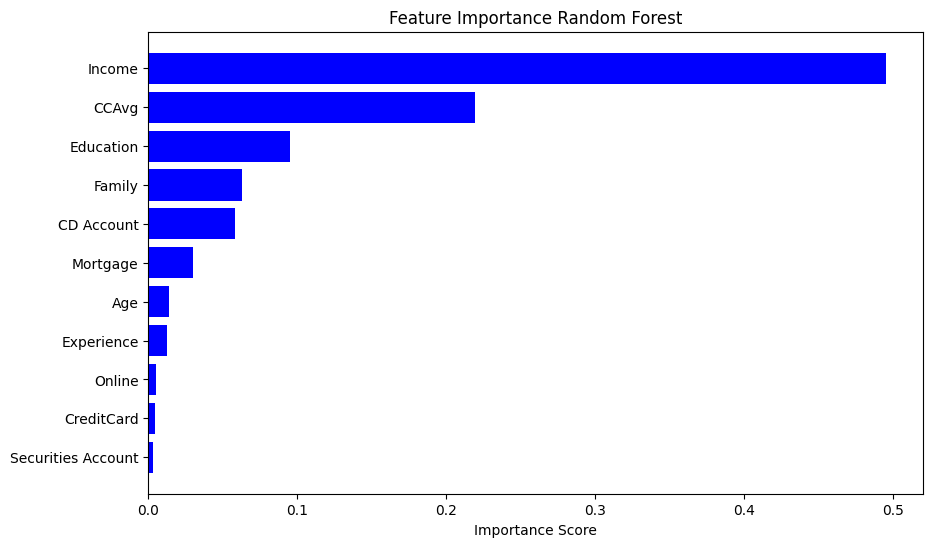

In [98]:
feature_importances_rf = best_rf.feature_importances_
importance_rf = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances_rf
})

importance_rf = importance_rf.sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(importance_rf['Feature'], importance_rf['Importance'], color='b')
plt.xlabel('Importance Score')
plt.title('Feature Importance Random Forest')
plt.gca().invert_yaxis()  
plt.show()

## Gradient Boosting

In [238]:
param_grid_gb = {
    'n_estimators': [50, 100, 150],         
    'learning_rate': [0.01, 0.05, 0.1],   
    'max_depth': [3, 4, 5],                
    'min_samples_split': [10, 15],         
    'min_samples_leaf': [5, 10],           
    'subsample': [0.6, 0.8],               
}

In [239]:
gb = GradientBoostingClassifier(random_state=42)
grid_search_gb = GridSearchCV(estimator=gb, param_grid=param_grid_gb, cv=10, n_jobs=-1, verbose=1)

In [240]:
grid_search_gb.fit(X_train, y_train)

Fitting 10 folds for each of 216 candidates, totalling 2160 fits


GridSearchCV(cv=10, estimator=GradientBoostingClassifier(random_state=42),
             n_jobs=-1,
             param_grid={'learning_rate': [0.01, 0.05, 0.1],
                         'max_depth': [3, 4, 5], 'min_samples_leaf': [5, 10],
                         'min_samples_split': [10, 15],
                         'n_estimators': [50, 100, 150],
                         'subsample': [0.6, 0.8]},
             verbose=1)

In [241]:
print("Best params:")
print(grid_search_gb.best_params_)

Best params:
{'learning_rate': 0.1, 'max_depth': 4, 'min_samples_leaf': 5, 'min_samples_split': 15, 'n_estimators': 150, 'subsample': 0.8}


In [242]:
best_gb = grid_search_gb.best_estimator_
y_pred_gb = best_gb.predict(X_test)
# classification_report(y_test, y_pred_gb

### Model evaluation

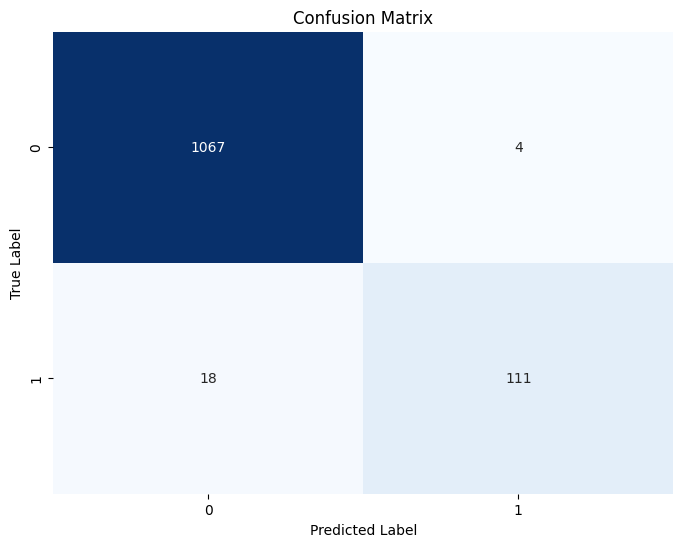

In [243]:
conf_matrix_gb = confusion_matrix(y_test, y_pred_gb)

plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix_gb, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

In [244]:
accuracy = accuracy_score(y_test, y_pred_gb)
precision = precision_score(y_test, y_pred_gb)
recall = recall_score(y_test, y_pred_gb)
f1 = f1_score(y_test, y_pred_gb)
roc_auc = roc_auc_score(y_test, best_gb.predict_proba(X_test)[:, 1])

metrics_table = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC'],
    'Score': [accuracy, precision, recall, f1, roc_auc]
})

metrics_table

,Metric,Score
0,Accuracy,0.981667
1,Precision,0.965217
2,Recall,0.860465
3,F1 Score,0.909836
4,ROC AUC,0.996895


- feature importance

In [251]:
feature_importances_gb = best_gb.feature_importances_
# importance_gb = pd.DataFrame({
#     'Feature': features,
#     'Importance': feature_importances_gb
# })

print(len(features), len(feature_importances_gb))


# importance_gb = importance_gb.sort_values(by='Importance', ascending=False)

# plt.figure(figsize=(10, 6))
# plt.barh(importance_gb['Feature'], importance_gb['Importance'], color='b')
# plt.xlabel('Importance Score')
# plt.title('Feature Importance Gradient Boosting')
# plt.gca().invert_yaxis()  
# plt.show()

7 12


## XG Boost

In [120]:
param_grid_xgb = {
    'n_estimators': [50, 100, 150],         
    'learning_rate': [0.01, 0.05, 0.1],     
    'max_depth': [3, 4, 5],                 
    'min_child_weight': [1, 5, 10],         
    'gamma': [0, 0.1, 0.2],                
    'subsample': [0.6, 0.8],                
    'colsample_bytree': [0.6, 0.8],         
    'reg_alpha': [0, 0.01, 0.1],            
    'reg_lambda': [1, 0.1],                 
}

In [123]:
xgb = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')
grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=10, n_jobs=-1, verbose=1)

In [124]:
grid_search_xgb.fit(X_train, y_train)

Fitting 10 folds for each of 5832 candidates, totalling 58320 fits


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [22:06:47] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [22:06:47] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [22:06:47] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [22:06:47] WARNING: /Users/runner/work/xgboost/xgboost/src

GridSearchCV(cv=10,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False,
                                     eval_metric='logloss', feature_types=None,
                                     gamma=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate...
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=42, ...),
             n_jobs=-1,
             param_grid={'colsample_bytree': [0.6, 0.8], 'gamma': [0, 0.1, 0.2],
                         'learning_rate': [0.01, 0.05, 0.1],
                         'max_depth': [3, 4, 5], 'min_child_weight': [1, 5, 10],
                         'n_estimators': [50, 100, 150],
                         'reg_alpha': [0, 0.01, 0.1], 'reg_lambda': [1, 0.1],
                         'subsample': [0.6, 0.8]},
             verbose=1)

In [125]:
best_xgb = grid_search_xgb.best_estimator_
y_pred_xgb = best_xgb.predict(X_test)

In [126]:
print("Best params for XGBoost:")
print(grid_search_xgb.best_params_)

Best params for XGBoost:
{'colsample_bytree': 0.8, 'gamma': 0.2, 'learning_rate': 0.1, 'max_depth': 3, 'min_child_weight': 1, 'n_estimators': 150, 'reg_alpha': 0.1, 'reg_lambda': 0.1, 'subsample': 0.8}


In [127]:
best_xgb = grid_search_xgb.best_estimator_
y_pred_xgb = best_xgb.predict(X_test)

### Model evaluation

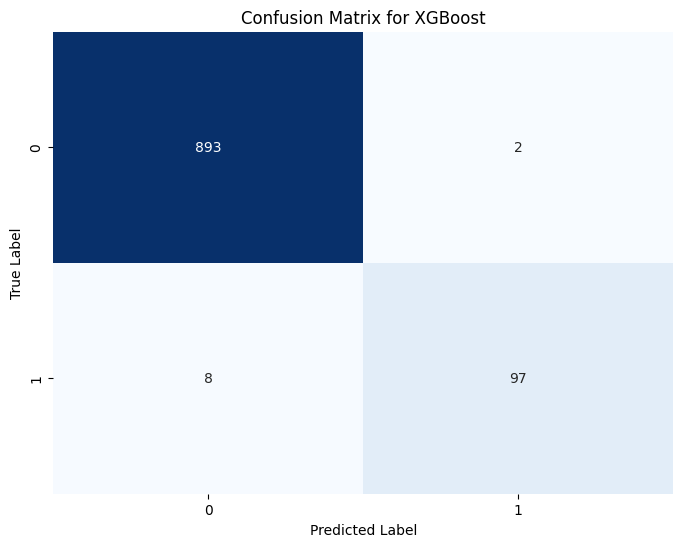

In [128]:
conf_matrix_xgb = confusion_matrix(y_test, y_pred_xgb)

plt.figure(figsize=(8,6))
sns.heatmap(conf_matrix_xgb, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.title('Confusion Matrix for XGBoost')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

In [130]:
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
precision_xgb = precision_score(y_test, y_pred_xgb)
recall_xgb = recall_score(y_test, y_pred_xgb)
f1_xgb = f1_score(y_test, y_pred_xgb)
roc_auc_xgb = roc_auc_score(y_test, best_xgb.predict_proba(X_test)[:, 1])

metrics_table_xgb = pd.DataFrame({
    'Metric': ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC'],
    'Score': [accuracy_xgb, precision_xgb, recall_xgb, f1_xgb, roc_auc_xgb]
})

metrics_table_xgb

,Metric,Score
0,Accuracy,0.990000
1,Precision,0.979798
2,Recall,0.923810
3,F1 Score,0.950980
4,ROC AUC,0.998627


- Feature importance

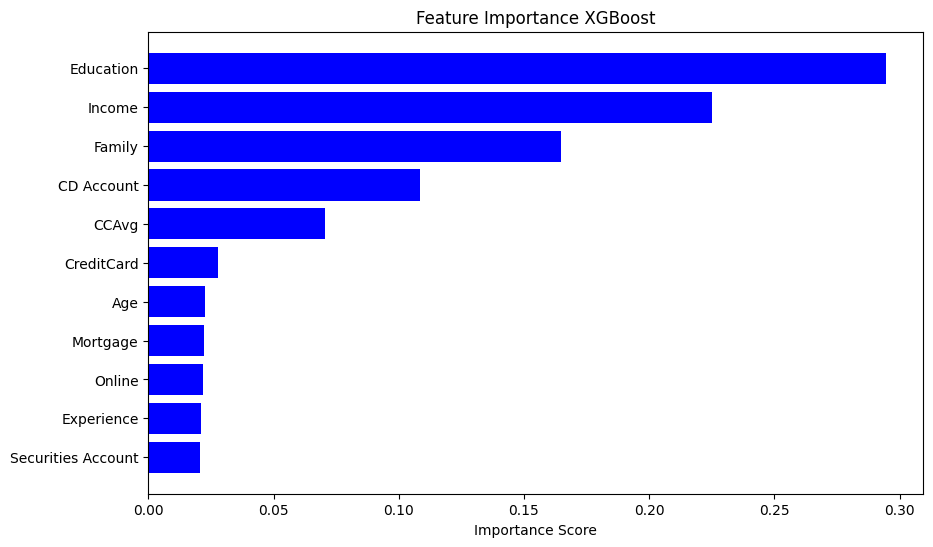

In [132]:
feature_importances_xgb = best_xgb.feature_importances_
importance_xgb = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances_xgb
})

importance_xgb = importance_xgb.sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(importance_xgb['Feature'], importance_xgb['Importance'], color='b')
plt.xlabel('Importance Score')
plt.title('Feature Importance XGBoost')
plt.gca().invert_yaxis()  # Invert y-axis to have the most important feature at the top
plt.show()

## Performance comparison

In [133]:
accuracy_logreg = accuracy_score(y_test, y_pred_logreg)
precision_logreg = precision_score(y_test, y_pred_logreg)
recall_logreg = recall_score(y_test, y_pred_logreg)
f1_logreg = f1_score(y_test, y_pred_logreg)

accuracy_rf = accuracy_score(y_test, y_pred_rf)
precision_rf = precision_score(y_test, y_pred_rf)
recall_rf = recall_score(y_test, y_pred_rf)
f1_rf = f1_score(y_test, y_pred_rf)

accuracy_gb = accuracy_score(y_test, y_pred_gb)
precision_gb = precision_score(y_test, y_pred_gb)
recall_gb = recall_score(y_test, y_pred_gb)
f1_gb = f1_score(y_test, y_pred_gb)

accuracy_xgb = accuracy_score(y_test, y_pred_xgb)
precision_xgb = precision_score(y_test, y_pred_xgb)
recall_xgb = recall_score(y_test, y_pred_xgb)
f1_xgb = f1_score(y_test, y_pred_xgb)

metrics_table = pd.DataFrame({
    'Model': ['Logistic Regression', 'Random Forest', 'Gradient Boosting', 'XGBoost'],
    'Test Accuracy': [accuracy_logreg, accuracy_rf, accuracy_gb, accuracy_xgb],
    'Precision': [precision_logreg, precision_rf, precision_gb, precision_xgb],
    'Recall': [recall_logreg, recall_rf, recall_gb, recall_xgb],
    'F1 Score': [f1_logreg, f1_rf, f1_gb, f1_xgb]
})
metrics_table

,Model,Test Accuracy,Precision,Recall,F1 Score
0,Logistic Regression,0.954,0.855422,0.676190,0.755319
1,Random Forest,0.977,0.836066,0.971429,0.898678
2,Gradient Boosting,0.991,0.980000,0.933333,0.956098
3,XGBoost,0.990,0.979798,0.923810,0.950980


<Figure size 1000x700 with 0 Axes>

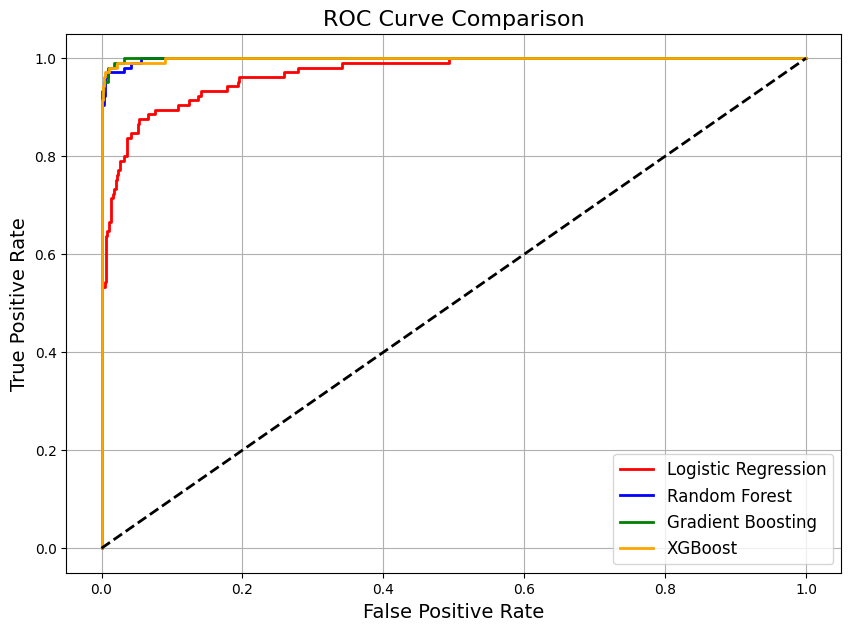

In [136]:
y_pred_logreg_proba = pipeline_logreg.predict_proba(X_test)[:, 1]  # Logistic Regression probabilities
y_pred_rf_proba = best_rf.predict_proba(X_test)[:, 1]  # Random Forest probabilities
y_pred_gb_proba = grid_search_gb.best_estimator_.predict_proba(X_test)[:, 1]  # Gradient Boosting probabilities
y_pred_xgb_proba = best_xgb.predict_proba(X_test)[:, 1]  # XGBoost probabilities

fpr_logreg, tpr_logreg, _ = roc_curve(y_test, y_pred_logreg_proba)
roc_auc_logreg = auc(fpr_logreg, tpr_logreg)

fpr_rf, tpr_rf, _ = roc_curve(y_test, y_pred_rf_proba)
roc_auc_rf = auc(fpr_rf, tpr_rf)

fpr_gb, tpr_gb, _ = roc_curve(y_test, y_pred_gb_proba)
roc_auc_gb = auc(fpr_gb, tpr_gb)

fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_pred_xgb_proba)
roc_auc_xgb = auc(fpr_xgb, tpr_xgb)

plt.figure(figsize=(10, 7))
plt.figure(figsize=(10, 7))
plt.plot(fpr_logreg, tpr_logreg, label=f'Logistic Regression', color='red', linewidth=2)
plt.plot(fpr_rf, tpr_rf, label=f'Random Forest', color='blue', linewidth=2)
plt.plot(fpr_gb, tpr_gb, label=f'Gradient Boosting', color='green', linewidth=2)
plt.plot(fpr_xgb, tpr_xgb, label=f'XGBoost', color='orange', linewidth=2)
plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
plt.title('ROC Curve Comparison', fontsize=16)
plt.xlabel('False Positive Rate', fontsize=14)
plt.ylabel('True Positive Rate', fontsize=14)
plt.legend(loc='lower right', fontsize=12)
plt.grid(True)

plt.show()


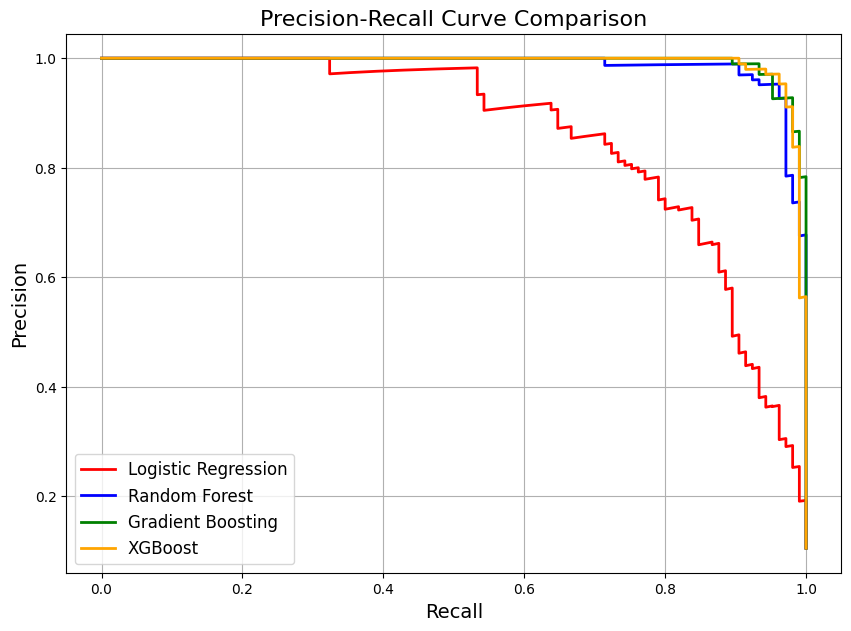

In [137]:
precision_logreg, recall_logreg, _ = precision_recall_curve(y_test, y_pred_logreg_proba)
precision_rf, recall_rf, _ = precision_recall_curve(y_test, y_pred_rf_proba)
precision_gb, recall_gb, _ = precision_recall_curve(y_test, y_pred_gb_proba)
precision_xgb, recall_xgb, _ = precision_recall_curve(y_test, y_pred_xgb_proba)

plt.figure(figsize=(10, 7))
plt.plot(recall_logreg, precision_logreg, label='Logistic Regression', color='red', linewidth=2)
plt.plot(recall_rf, precision_rf, label='Random Forest', color='blue', linewidth=2)
plt.plot(recall_gb, precision_gb, label='Gradient Boosting', color='green', linewidth=2)
plt.plot(recall_xgb, precision_xgb, label='XGBoost', color='orange', linewidth=2)

plt.title('Precision-Recall Curve Comparison', fontsize=16)
plt.xlabel('Recall', fontsize=14)
plt.ylabel('Precision', fontsize=14)
plt.legend(loc='lower left', fontsize=12)
plt.grid(True)
plt.show()


## Model interpretability

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/shap/explainers/_linear.py:95: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


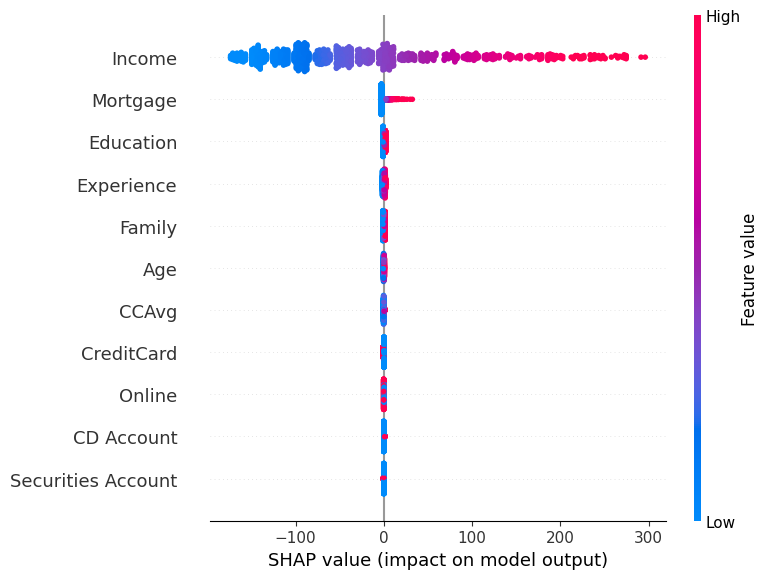

In [119]:
explainer_logreg = shap.LinearExplainer(pipeline_logreg.named_steps['logreg'], X_train, feature_perturbation="interventional")
shap_values_logreg = explainer_logreg.shap_values(X_test)
shap.summary_plot(shap_values_logreg, X_test, feature_names=X_test.columns)

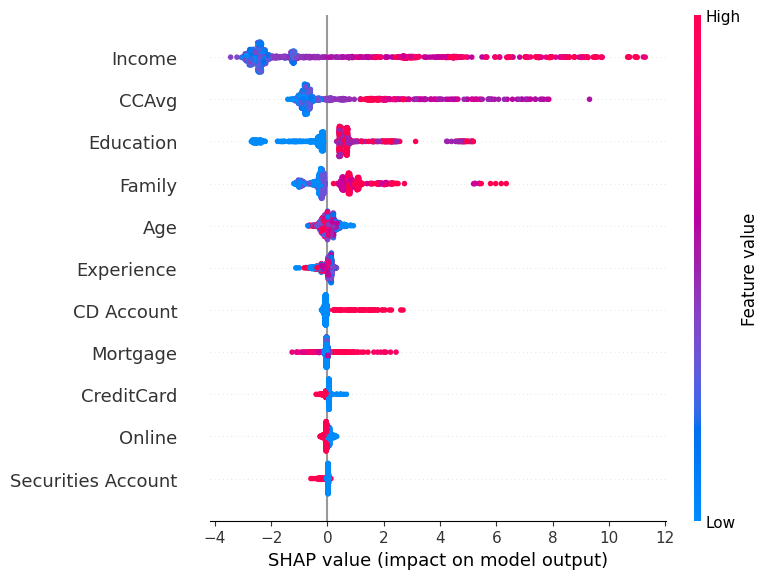

In [112]:
explainer_gb = shap.Explainer(best_gb) 
shap_values_gb = explainer_gb.shap_values(X_test)
shap.summary_plot(shap_values_gb, X_test, feature_names=X_test.columns)


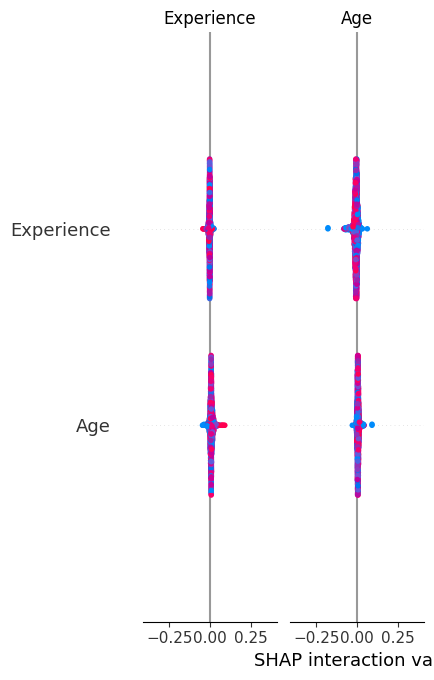

In [113]:
explainer_rf = shap.Explainer(best_rf) 
shap_values_rf = explainer_rf.shap_values(X_test)
shap.summary_plot(shap_values_rf, X_test, feature_names=X_test.columns)

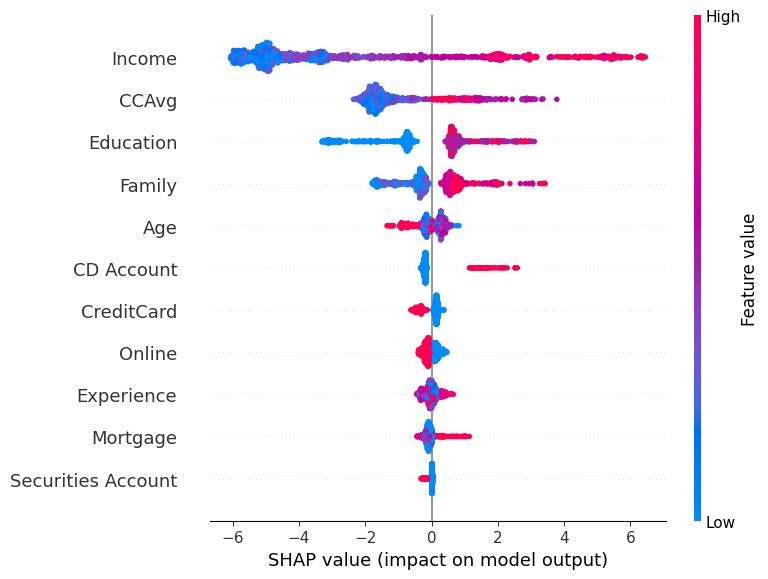

In [138]:
explainer_xgb = shap.Explainer(best_xgb)
shap_values_xgb = explainer_xgb.shap_values(X_test)
shap.summary_plot(shap_values_xgb, X_test, feature_names=X_test.columns)

NOTE: 
- se aggiungo colonna con valori univoci già dalla correlazione non riesco a vederla quindi capisco che va tolta
- feature selection non fas cosi tanta selection perchè le fesatures sono poche 